In [43]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [44]:
# Required plotting setting
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')
#plt.style.use('default')

import seaborn as sns
_font_size = 7.5
sns.set_context("paper", rc={"font.size":_font_size,"axes.titlesize":_font_size+1,"axes.labelsize":_font_size})   

# 2. Load data

In [3]:
merlin_output_master_folder = r'\\mendel\Mendel_SSD3\MERFISH_Analysis'
merlin_output_folders = [
    os.path.join(merlin_output_master_folder, r'20221003-hMTG_hM1'),
    os.path.join(merlin_output_master_folder, r'20221007-hMTG_hM1'),
    os.path.join(merlin_output_master_folder, r'20221011-hMTG_hM1'),
]
adata_list = []
for _data_folder in merlin_output_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    # load postanalysis h5ad
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
# merge
merged_adata = anndata.concat(adata_list, )

In [4]:
figure_folder = os.path.join(merlin_output_master_folder, 'hMTG_hM1_summary')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

sc.settings.figdir = figure_folder

Use figure_folder: \\mendel\Mendel_SSD3\MERFISH_Analysis\hMTG_hM1_summary


# 3. Preprocess and filter the MERFISH data 

In [5]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\anndata\_core\anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'experiment' as categorical


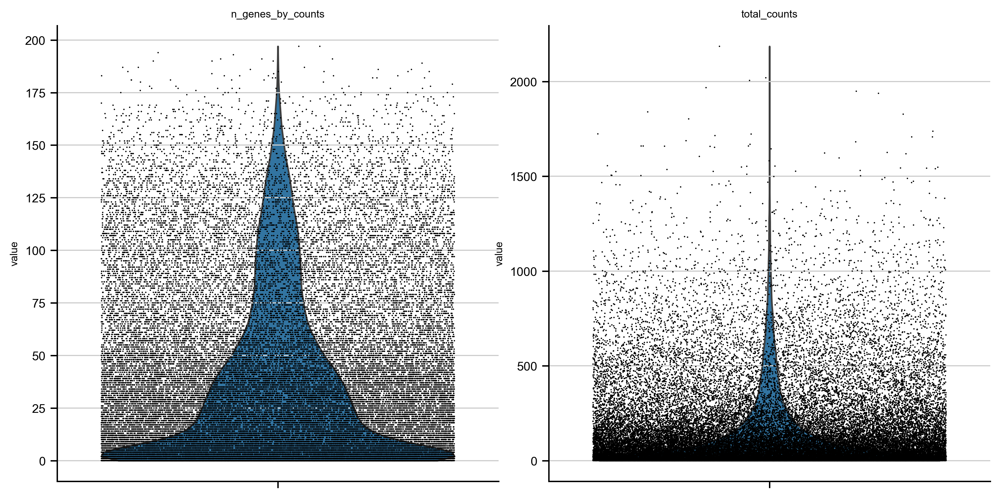

In [6]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_before_filter.png')

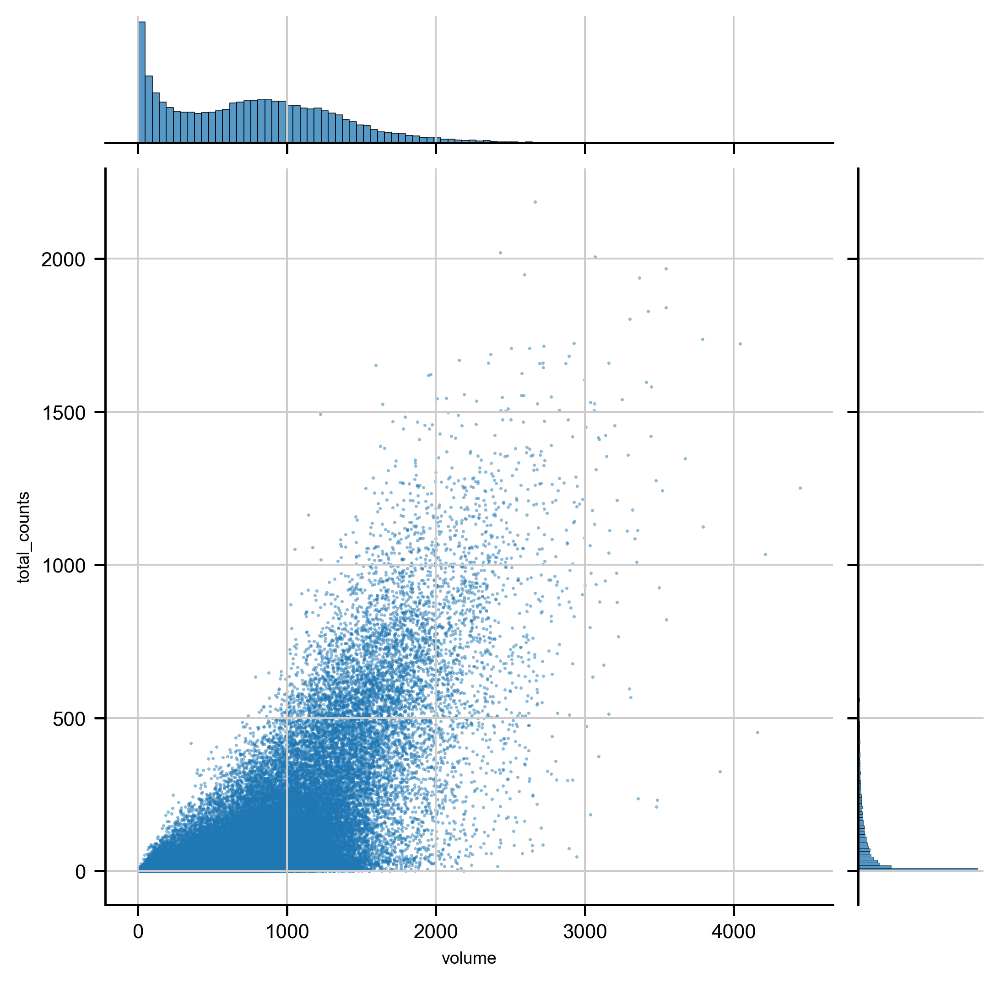

In [7]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts', s=2, linewidth=0, alpha=0.5)

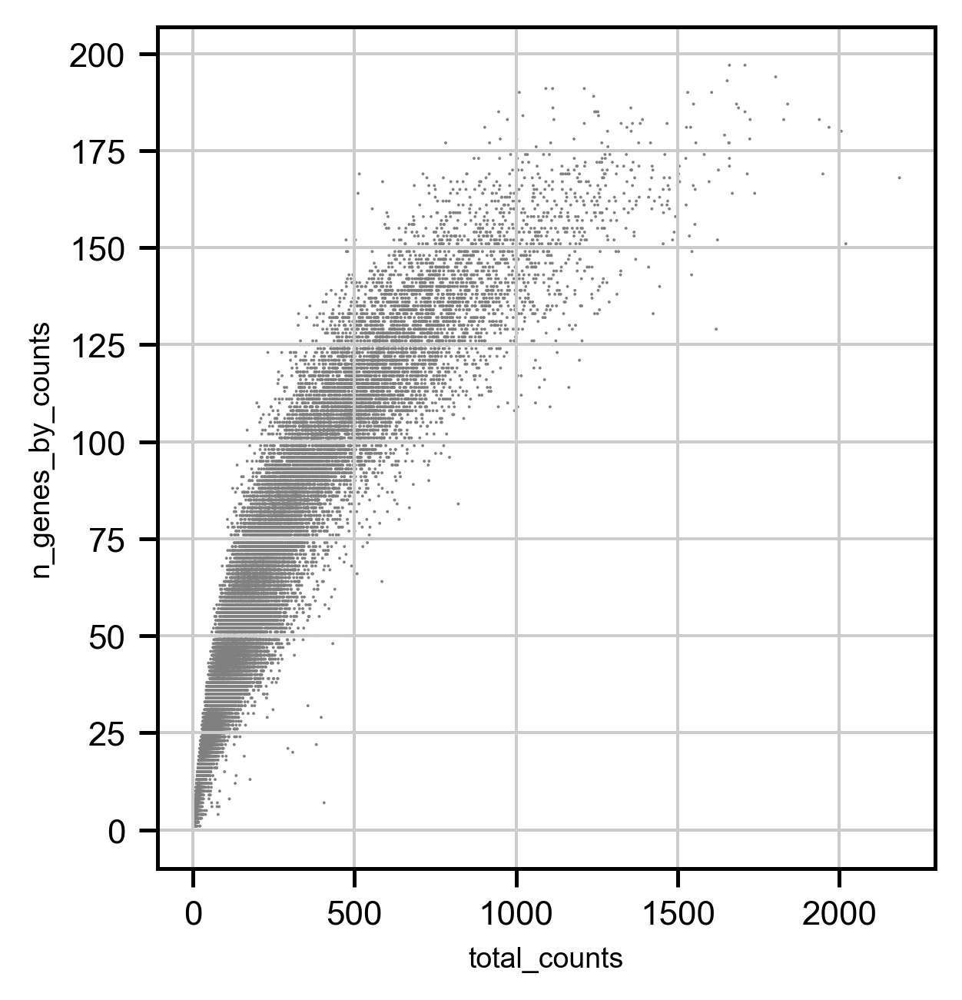

In [8]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [9]:
gene_count_threshold = 5
total_count_threshold = 5
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

37279


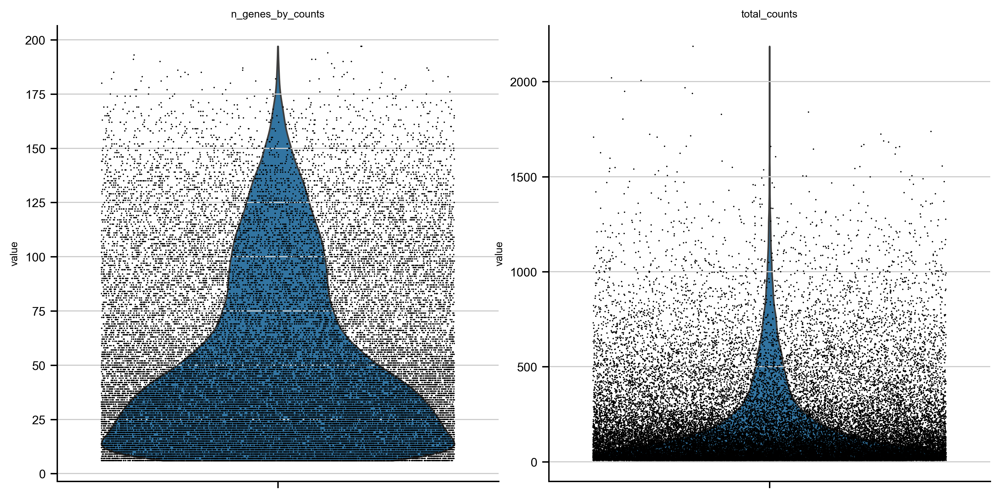

In [10]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_after_filter.png')

In [11]:
np.mean(merged_adata.obs['total_counts']), np.median(merged_adata.obs['total_counts'])

(194.53297424316406, 102.0)

## filter doublet

In [12]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:182: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.78
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.4%


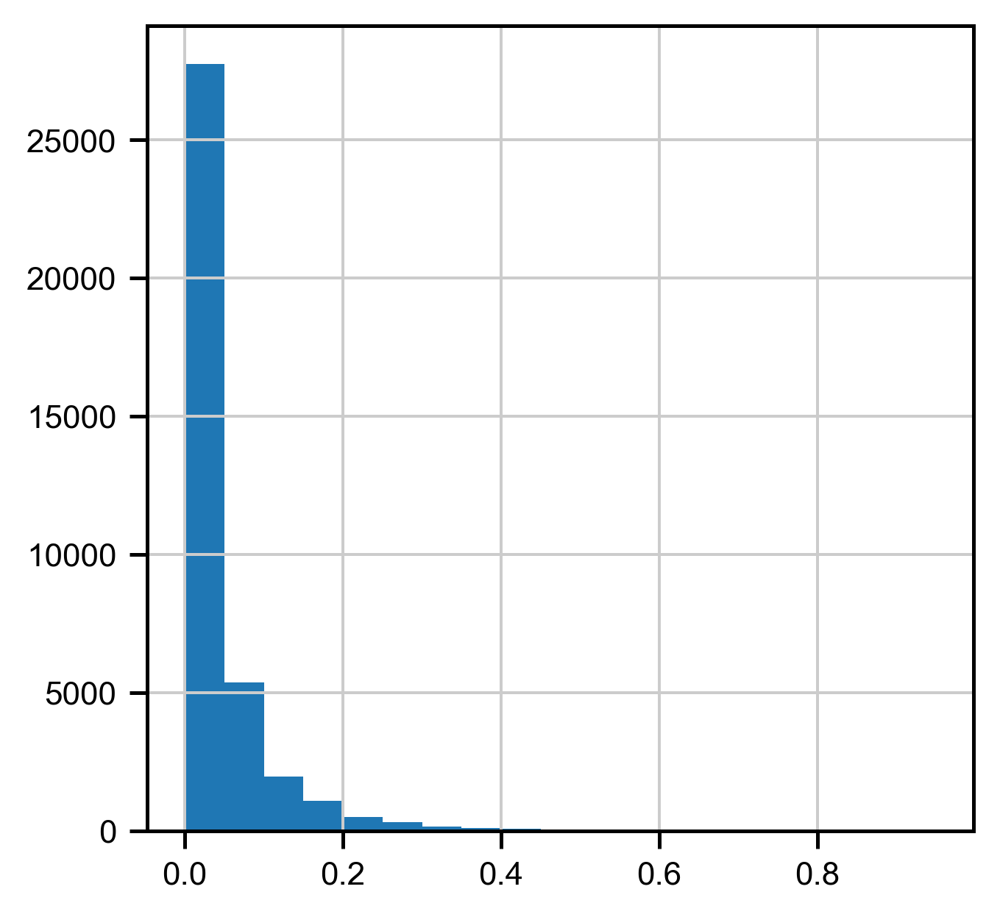

0.030499745164838114

In [13]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.2)

In [14]:
# remove potential doublet
doublet_score_th = 0.2
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

36142

# 4. PCA and UMAP of the MERFISH data (for quick test)

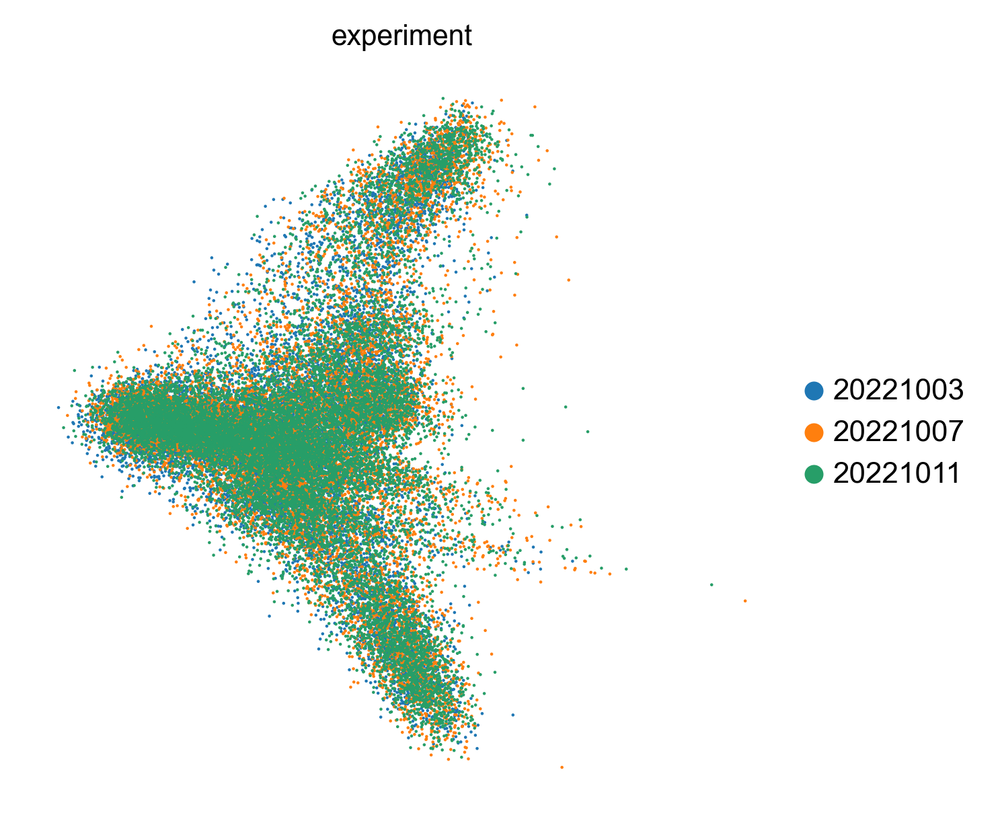

In [16]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata, color='experiment', save='_all_cells.png')

In [62]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=5, n_pcs=30)
# Clustering
sc.tl.leiden(merged_adata, resolution=0.5)

CPU times: total: 49.9 s
Wall time: 5.57 s


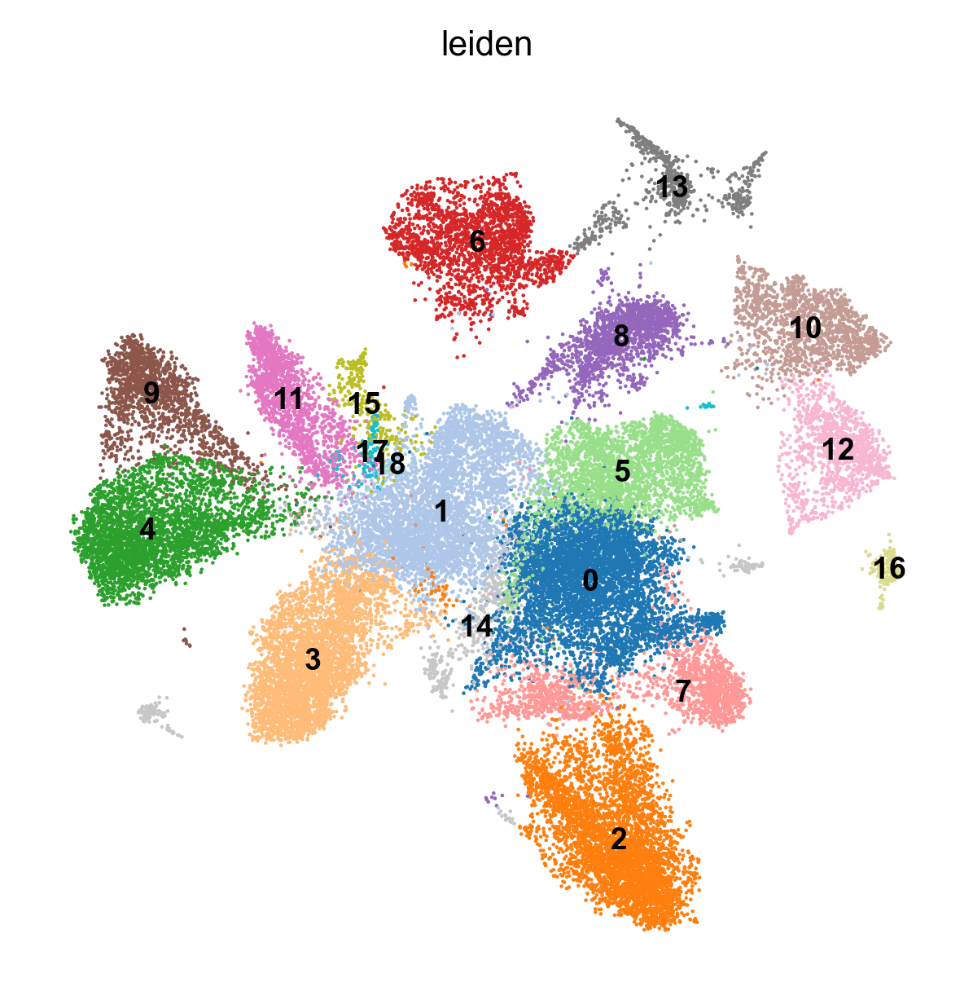

CPU times: total: 2min 12s
Wall time: 18.9 s


In [63]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', 
           legend_loc='on data',
           palette='tab20',
           save='_cluster.png',
           )

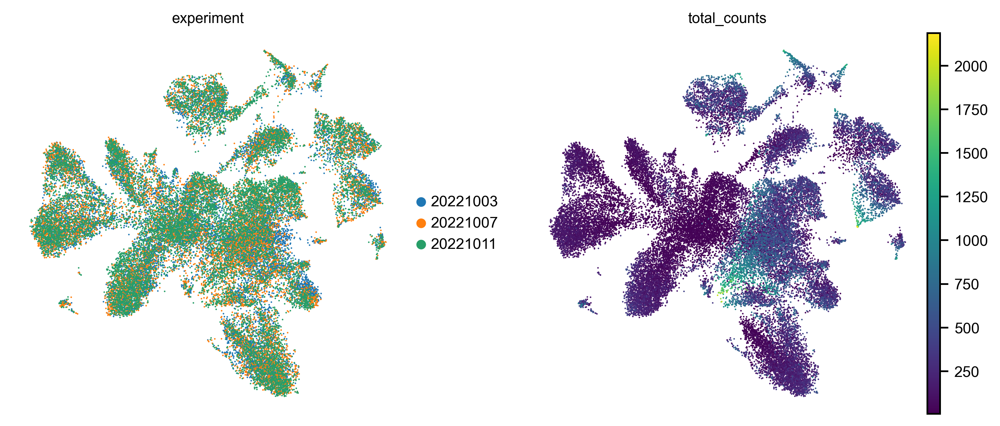

In [64]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'total_counts'], 
           save='_experiment_counts.png',)

# 5. Check count for each cell for genes of interest

In [65]:
# direcly use previous leiden
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

## T-test to identify marker genes

E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value enco

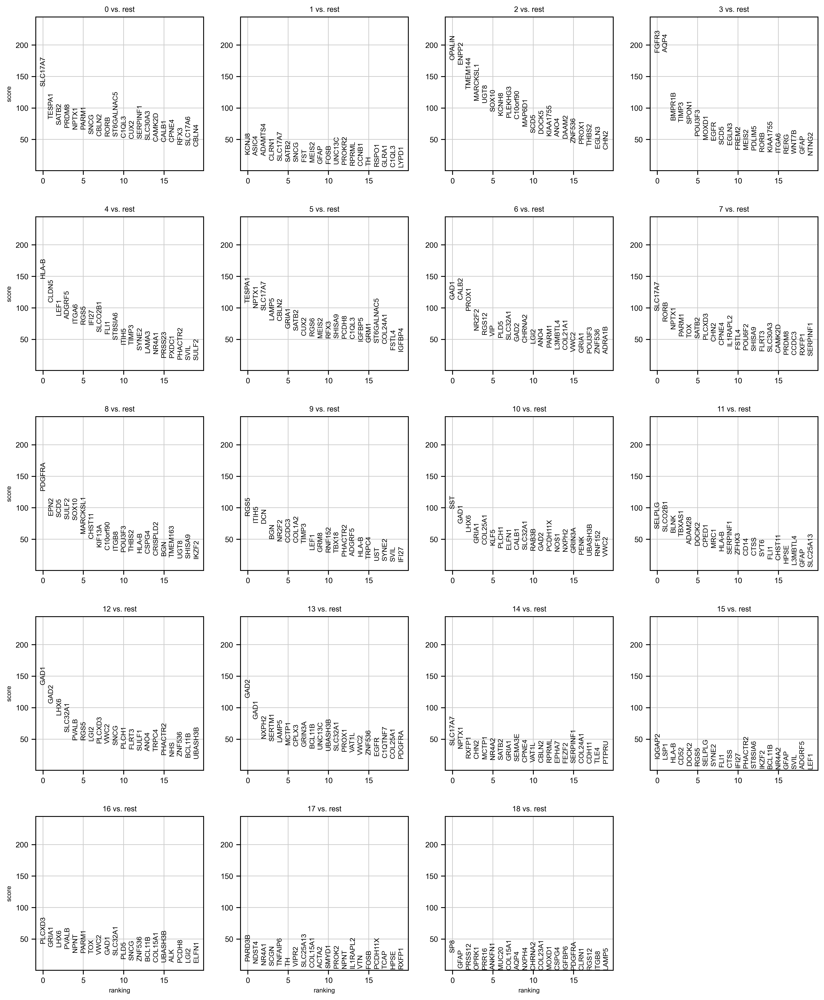

In [66]:
sc.tl.rank_genes_groups(merged_adata, groupby='leiden_cluster', method='t-test')
sc.pl.rank_genes_groups(merged_adata, groupby='leiden_cluster')

In [67]:
gene_ordering = np.array([list(_gnames) for _gnames in merged_adata.uns['rank_genes_groups']['names']])

In [81]:
# assign clusters
clusters = np.sort(np.unique(merged_adata.obs['leiden_cluster']).astype(np.int32))

# Inhibitory
inhibitory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='GAD1')[0] < 10:
        print(_i, end=', ')
        inhibitory_clusters.append(_i)
# excitatory
print("")
excitatory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='SLC17A7')[0] < 10:
        print(_i, end=', ')
        excitatory_clusters.append(_i)
nonneuron_clusters = []
for _i in clusters:
    if _i not in inhibitory_clusters and _i not in excitatory_clusters:
        nonneuron_clusters.append(_i)

6, 10, 12, 13, 16, 
0, 1, 5, 7, 14, 

In [100]:
n_nonneu = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in [11]:#nonneuron_clusters:
        n_nonneu += 1

print(n_nonneu / len(merged_adata.obs))
        

0.041779646948148966


In [97]:
n_gluta = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in excitatory_clusters:
        n_gluta += 1

print(n_gluta / len(merged_adata.obs))
        

0.3938907642078468


In [102]:
len(merged_adata.obs)

36142

0.0

In [ ]:
for _i in vars

In [69]:
gene_ordering[:10, 2]

array(['OPALIN', 'ENPP2', 'TMEM144', 'MARCKSL1', 'UGT8', 'SOX10', 'KCNH8',
       'PLEKHG3', 'C10orf90', 'MAP6D1'], dtype='<U10')

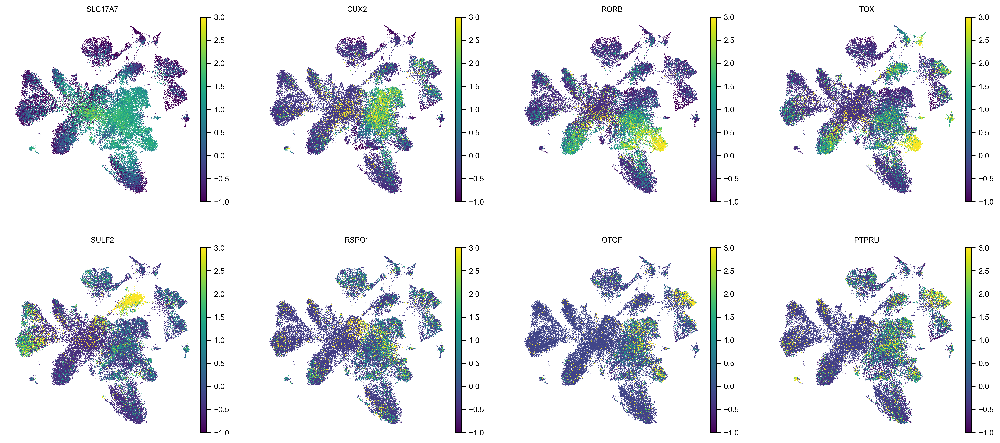

In [70]:
sc.pl.umap(merged_adata, color=['SLC17A7','CUX2','RORB', 'TOX', 'SULF2', 'RSPO1', 'OTOF','PTPRU'],
           vmin=-1, vmax=3, save='_excitatory_gene.png')

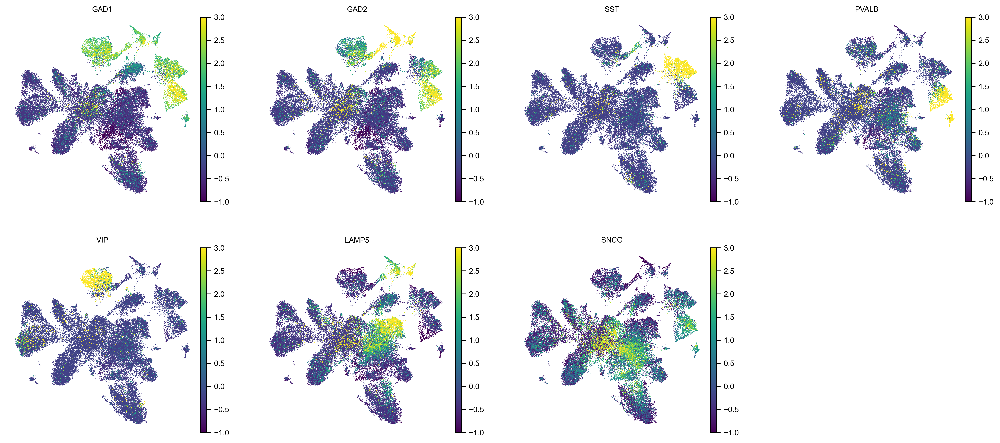

In [71]:
sc.pl.umap(merged_adata, color=['GAD1','GAD2','SST','PVALB','VIP','LAMP5','SNCG'],
           vmin=-1, vmax=3, save='_inhibitory_gene.png')

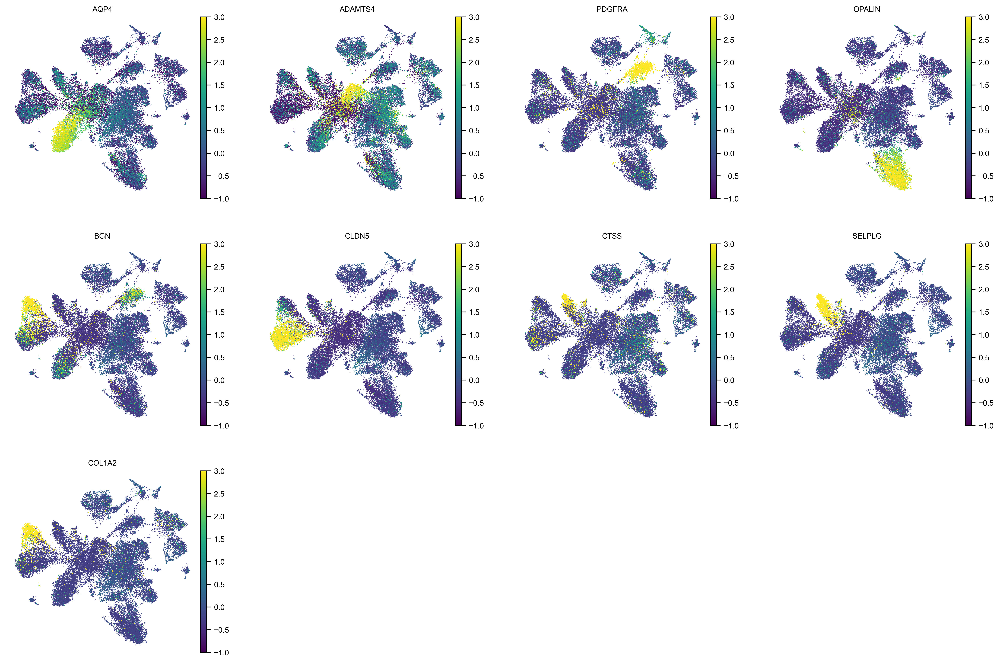

In [103]:
sc.pl.umap(merged_adata, color=['AQP4','ADAMTS4','PDGFRA','OPALIN','BGN','CLDN5', 'CTSS', 'SELPLG','COL1A2'],
           vmin=-1, vmax=3, save='_nonneuron_gene.png')

In [73]:
experiments = list(np.unique(merged_adata.obs['experiment']))
print(experiments)

['20221003', '20221007', '20221011']


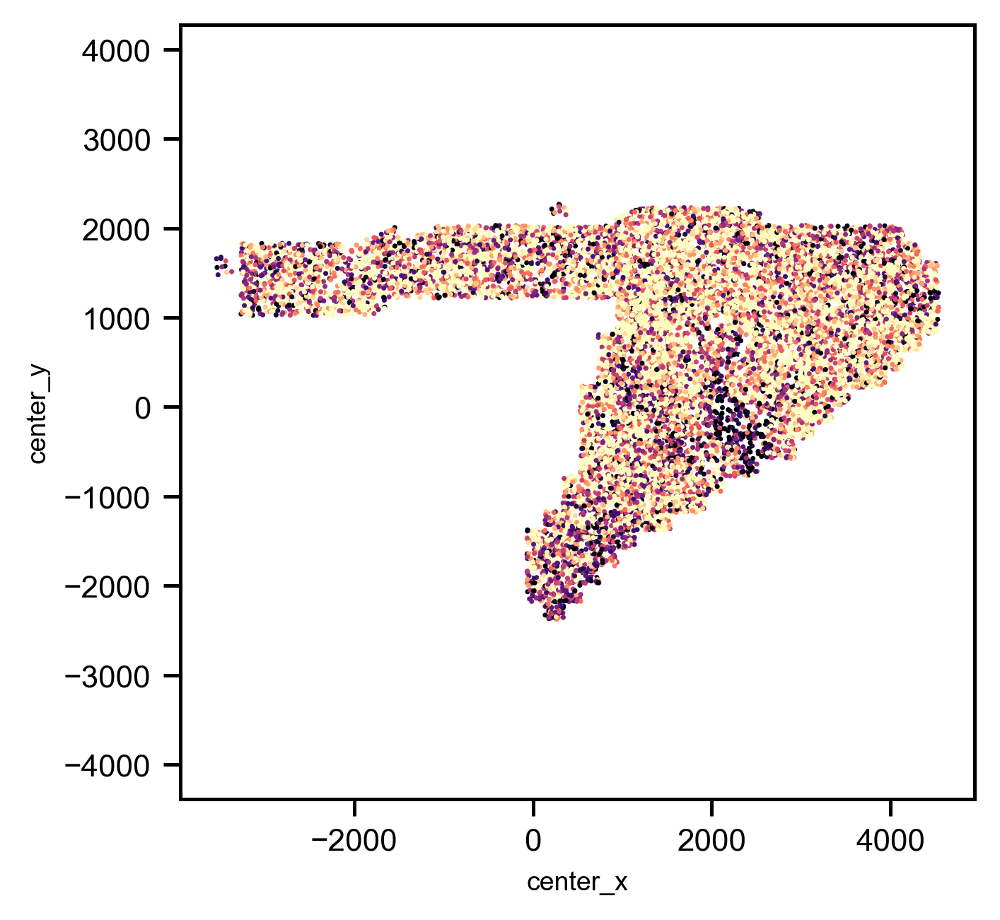

In [74]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
sel_experiment_id = 2
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     hue='total_counts', hue_norm=LogNorm(vmin=10,vmax=200), 
                     palette='magma',
                     s=2, linewidth=0,
                     legend=False, )
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
#ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial-total_counts_{experiments[sel_experiment_id]}.png'), 
            transparent=True)
plt.show()

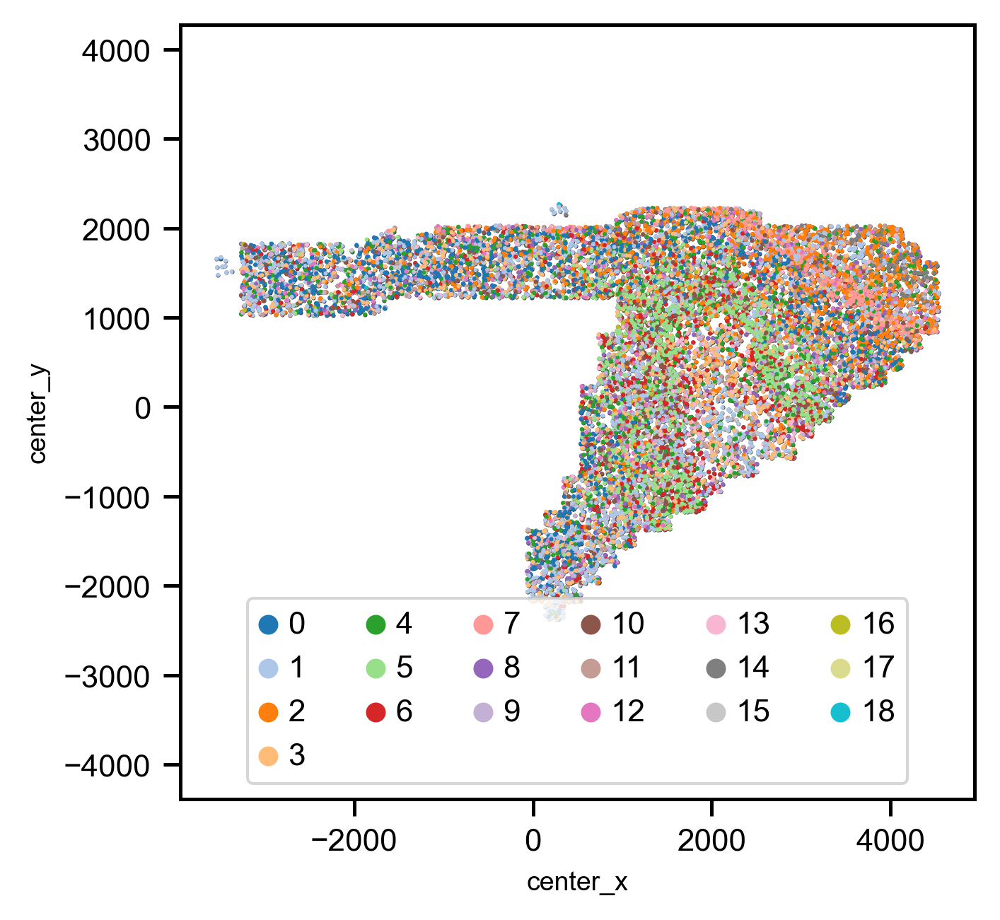

In [75]:
import matplotlib.pyplot as plt
# visualzie the spatial dist for clusters
sel_clusters = np.unique(sel_obs['leiden_cluster'])

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if _cls in sel_clusters]
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8)

plt.savefig(os.path.join(figure_folder, f'spatial-all_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

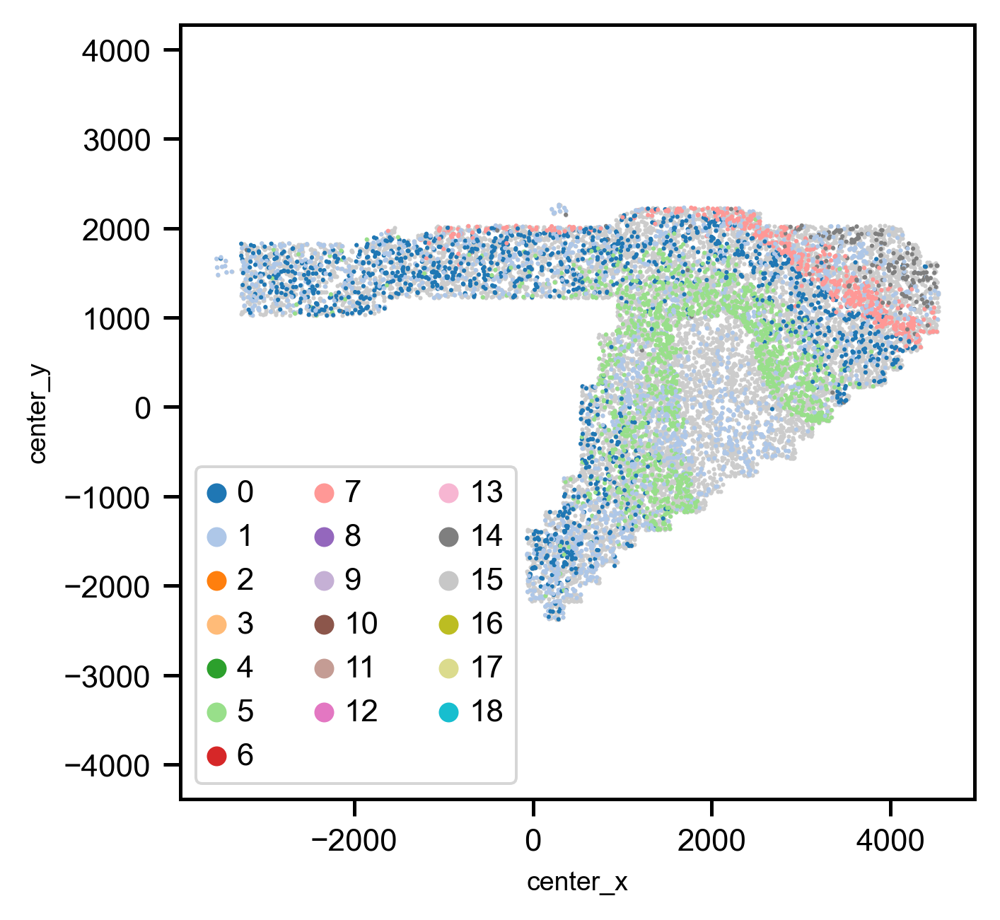

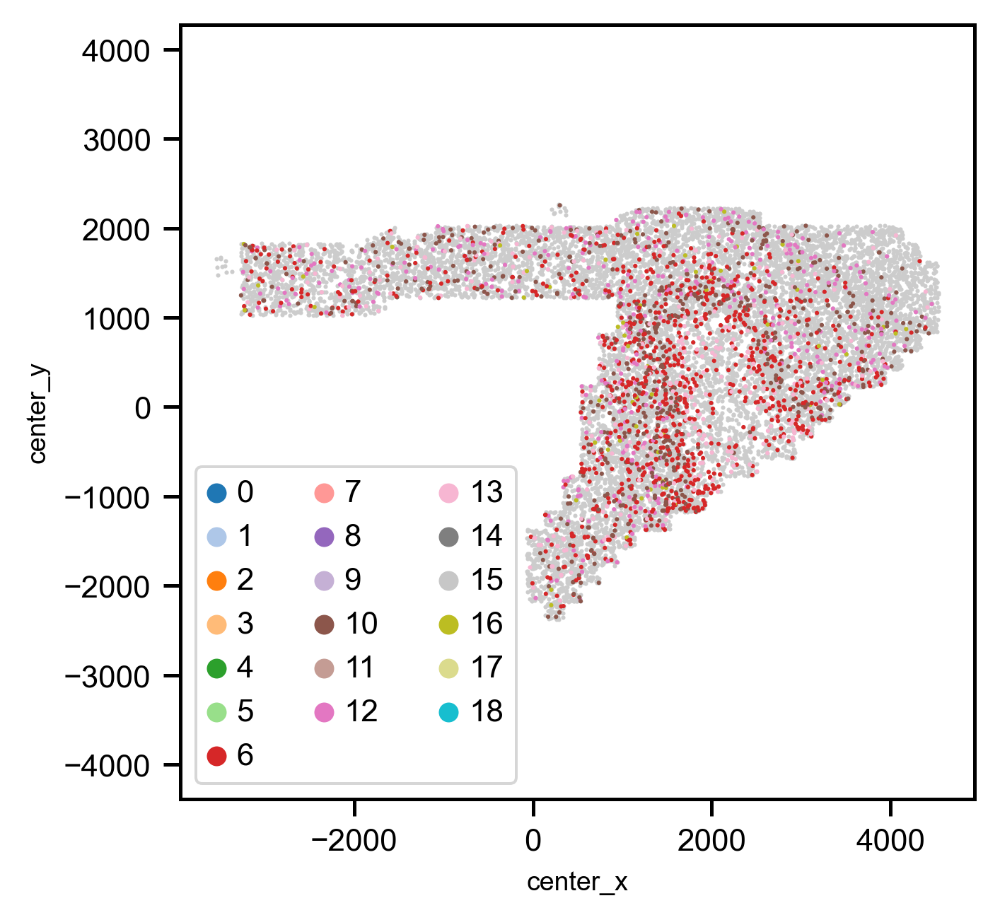

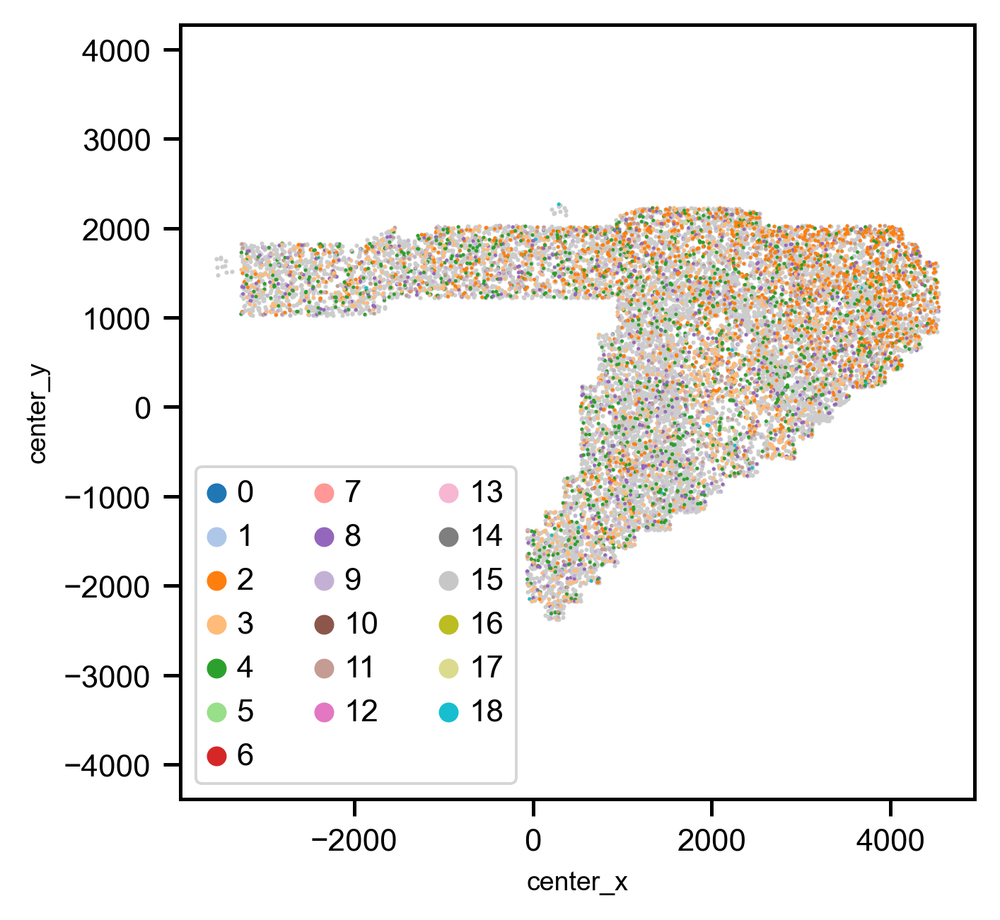

In [76]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [77]:
sel_experiment_id = 0
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

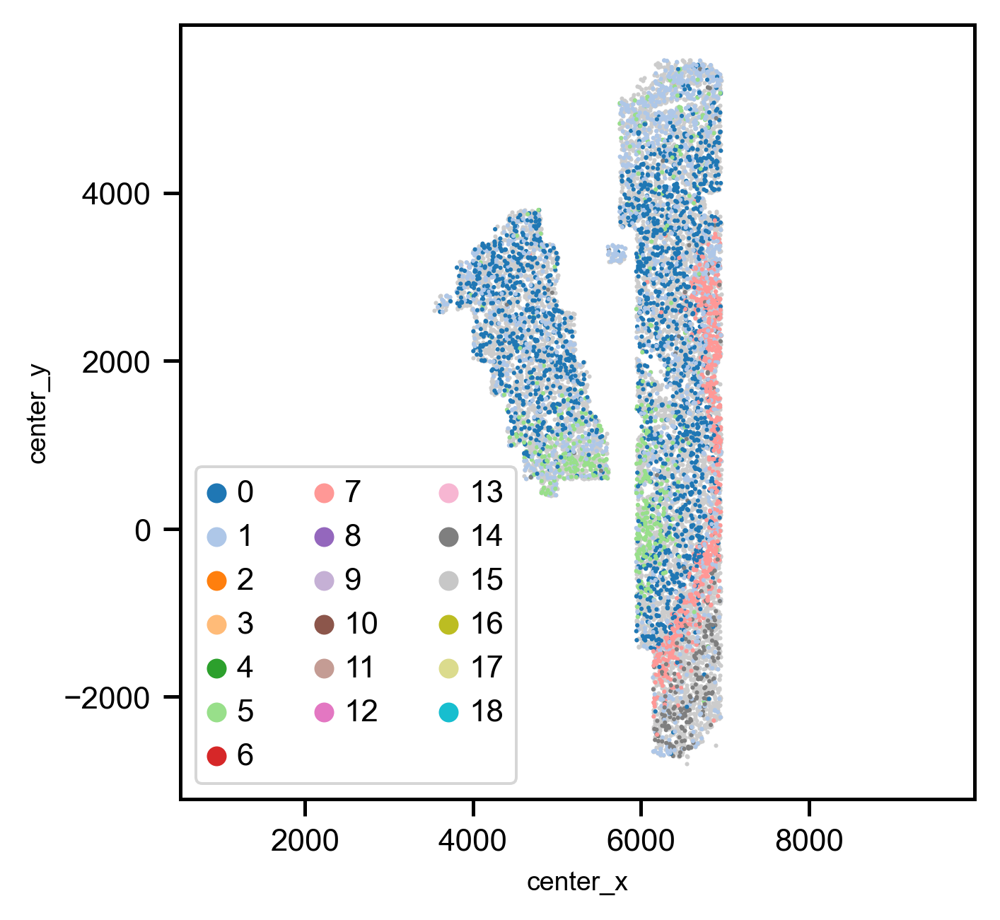

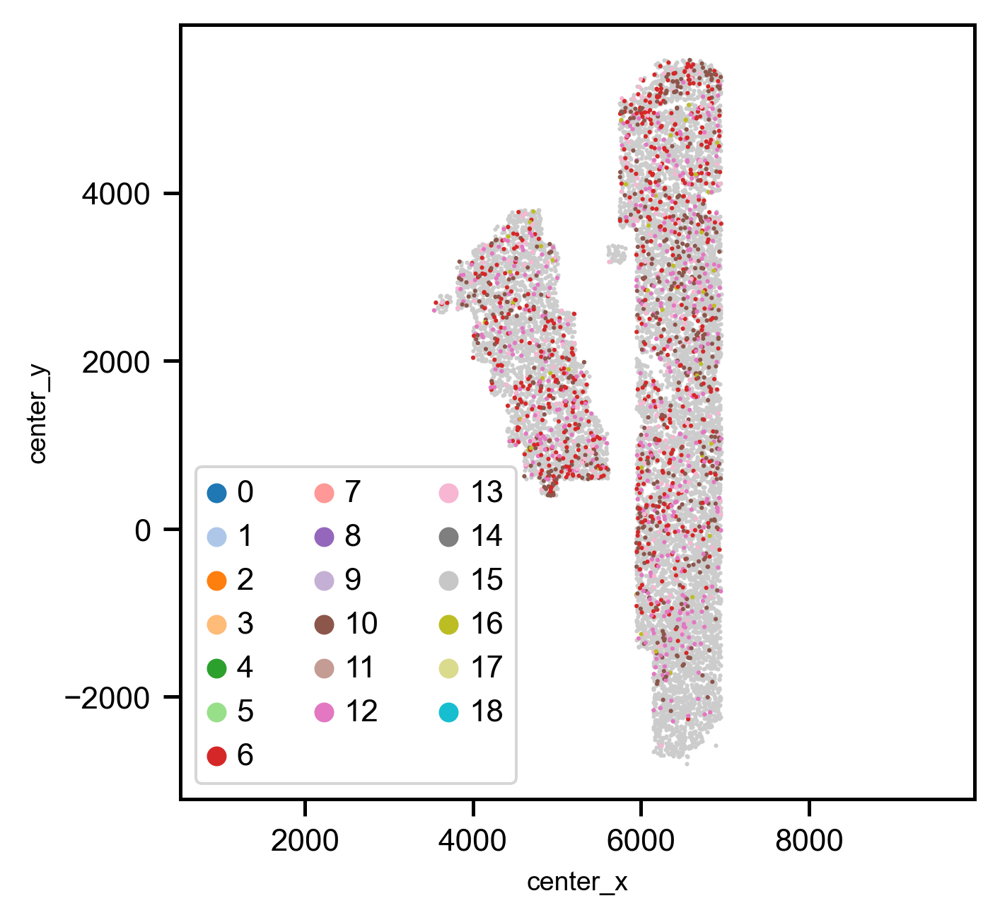

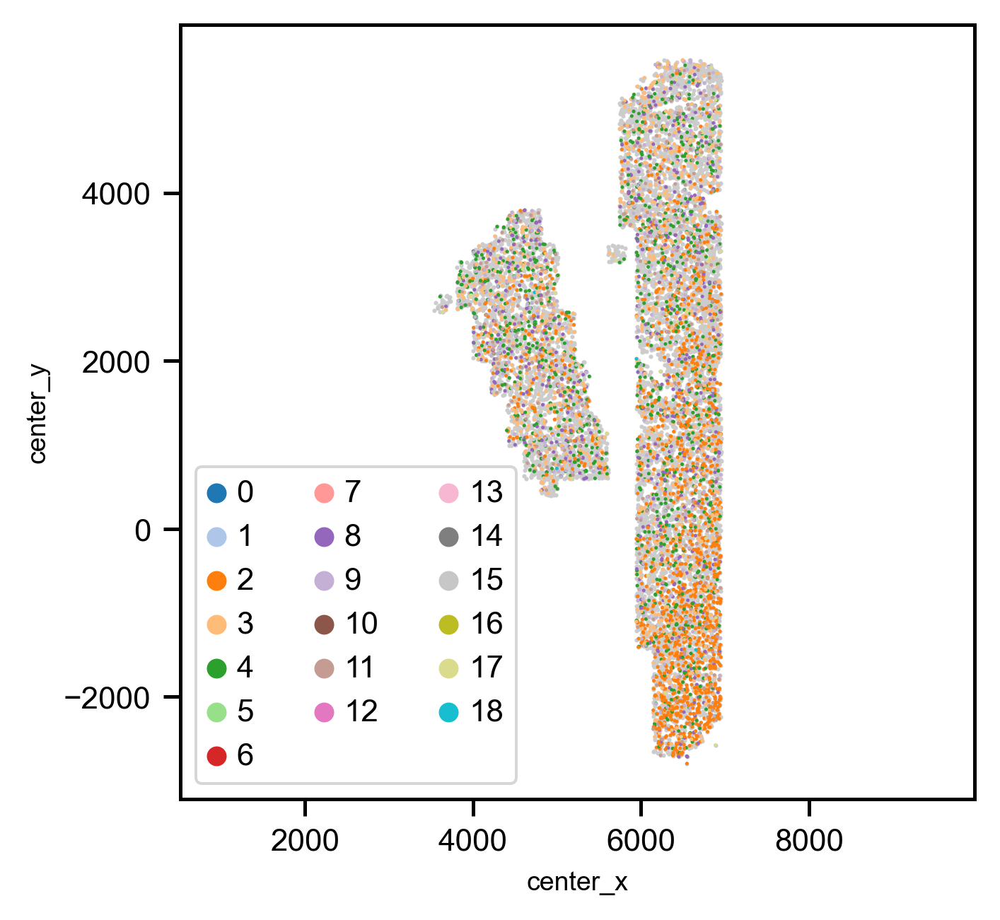

In [78]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [79]:
sel_experiment_id = 1
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

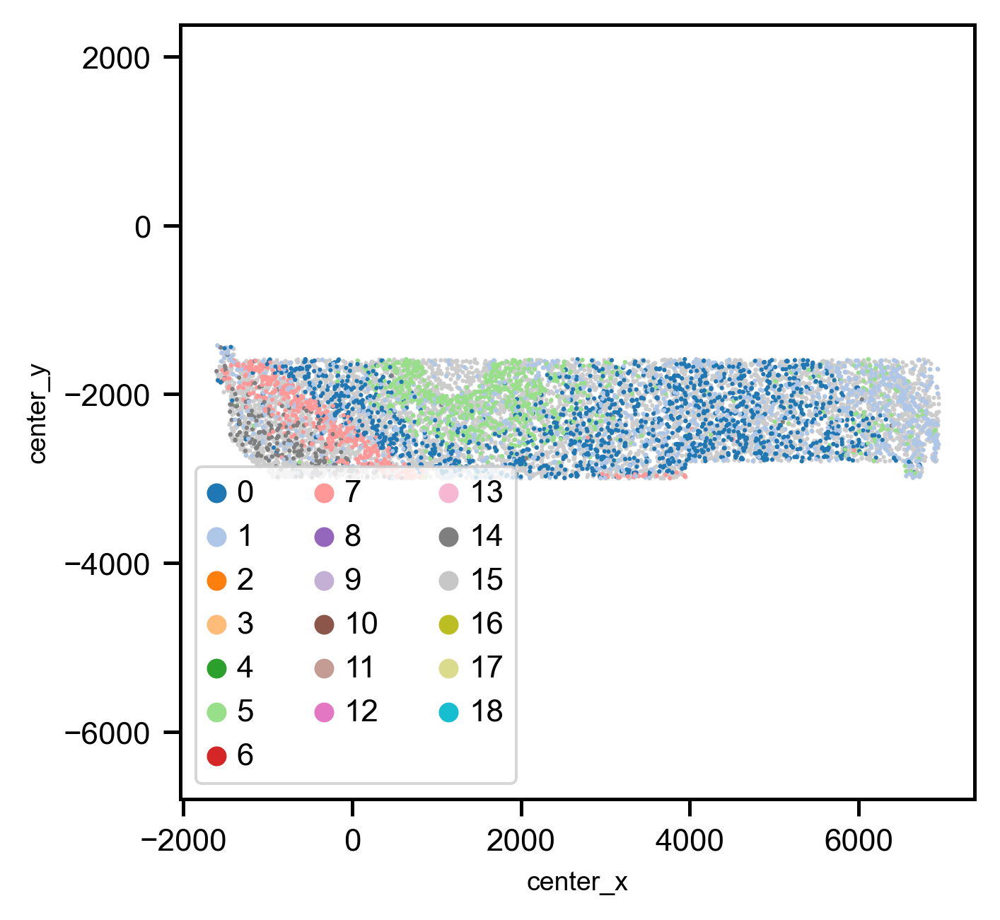

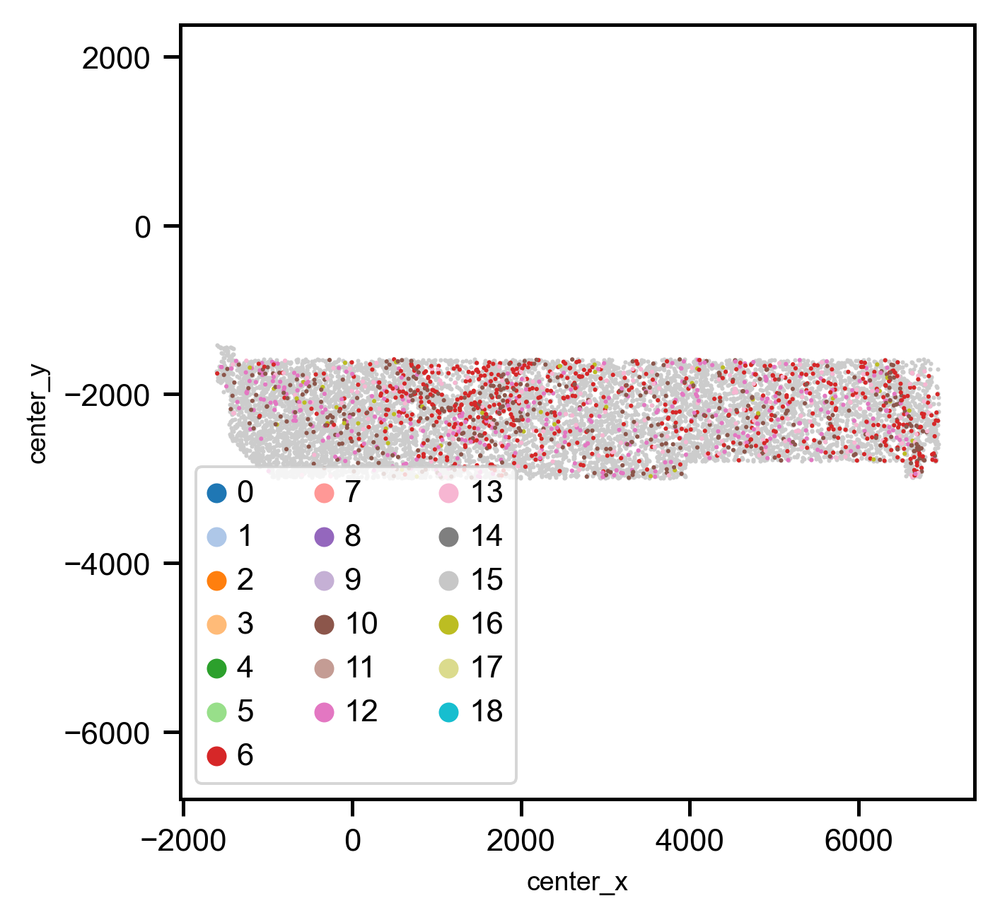

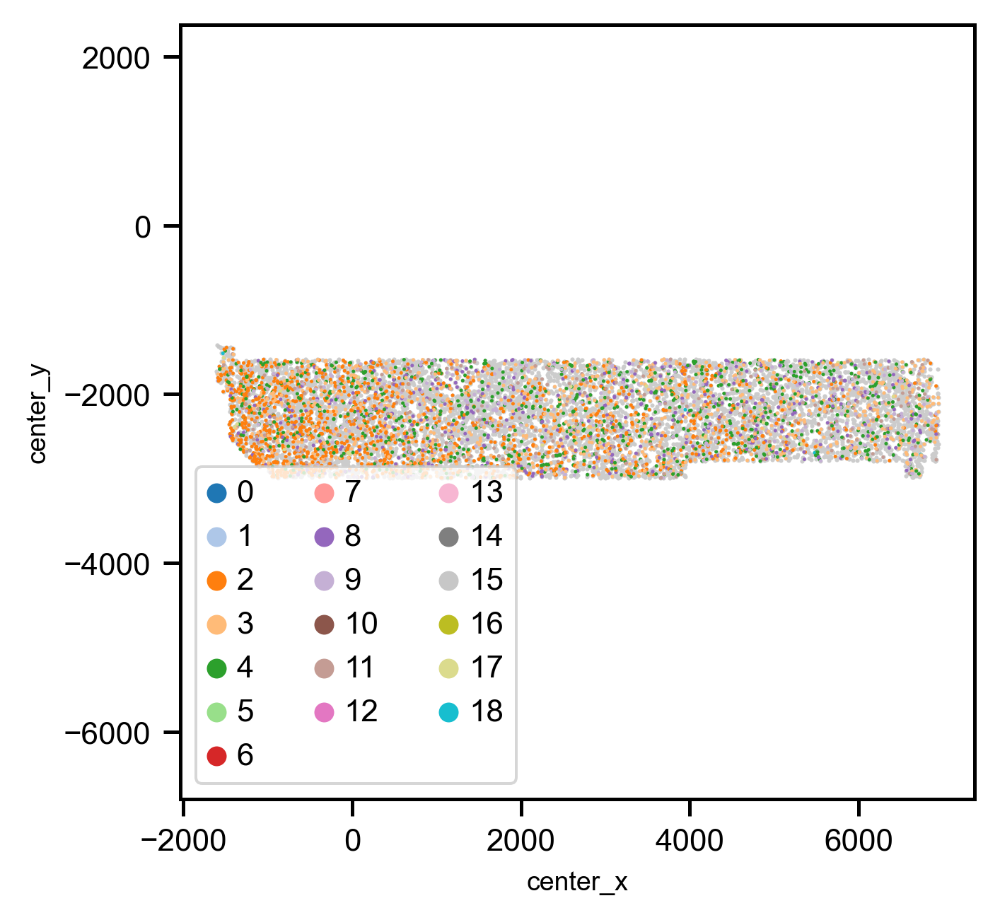

In [80]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1.5, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.8,0.8,0.8], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

# Run classifier